In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:

import numpy as np
import imageio as io
import math
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import random
import cv2
from scipy import ndimage
from torch.autograd import Variable
import sys
import os
from torchvision import datasets, transforms
from torch.utils.data import Dataset
from torch.autograd import Function, Variable


cuda = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
torch.manual_seed(5)
torch.cuda.manual_seed(5)

In [0]:
leftImageBoundingBox = [685.05, 804.68, 181.43, 258.21]
leftImageBoundingBox = [685, 805, 181, 258]
f = 721.537700
px = 609.559300
py = 172.854000
baseline = 0.5327119288
#directory = '/content/drive/My Drive/Colab Notebooks/a4/' # for colab
directory = 'a4/'

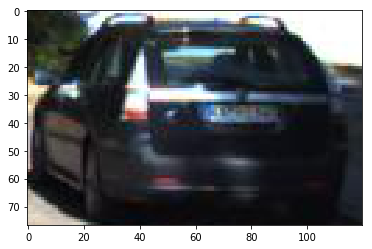

In [0]:
leftimage = io.imread(directory + 'A4_files/000020_left.jpg')
boundedImage = leftimage[181:258, 685: 805]
plt.imshow(boundedImage)
plt.show()

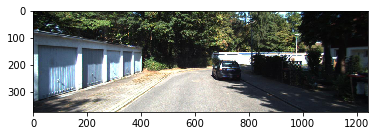

In [0]:
rightimage = io.imread(directory + 'A4_files/000020_right.jpg')
plt.imshow(rightimage)
plt.show()

In [0]:
def padImage(image, padWidth, channels):
    result = np.zeros((image.shape[0] + 2*padWidth, image.shape[1] + 2*padWidth, channels))

    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            result[i + padWidth, j + padWidth, :] = image[i, j, :]

    return result/255.0


def scan(lefImage, rightImage, boundingBox, patchSize):
    padWidth = math.floor(patchSize/2.0)

    paddedLeftImage = padImage(lefImage, padWidth, 3)
    paddedRightImage = padImage(rightImage, padWidth, 3)

    leftMatrix = np.zeros((boundingBox[3] - boundingBox[2], boundingBox[1] - boundingBox[0]))
    rightMatrix = np.zeros((boundingBox[3] - boundingBox[2], boundingBox[1] - boundingBox[0]))

    for i in range(boundingBox[2] + padWidth, boundingBox[3] + padWidth):
        for j in range(boundingBox[0] + padWidth, boundingBox[1] + padWidth):
            imagePatch = paddedLeftImage[i - padWidth : i + padWidth, j - padWidth:j + padWidth]
            minX, minSSD = scanRightImage(j, i, imagePatch, paddedRightImage, patchSize)

            leftMatrix[i - (boundingBox[2] + padWidth), j - (boundingBox[0] + padWidth)] = j - padWidth
            rightMatrix[i - (boundingBox[2] + padWidth), j - (boundingBox[0] + padWidth)] = minX - padWidth

    dispMatrix = leftMatrix - rightMatrix
    plt.imshow(dispMatrix[:, :])
    plt.show()
    print(dispMatrix)
    return dispMatrix
                                        



def scanRightImage(x, y, leftPatch, rightImage, patchSize):
    padWidth = math.floor(patchSize/2.0)
    minX = 0
    minSSD = float("inf")

    for j in range(padWidth, x + padWidth):
        rightPatch = rightImage[y-padWidth : y+padWidth, j - padWidth : j + padWidth]

        dif = rightPatch - leftPatch
        ssd = np.sum(dif * dif)

        if ssd < minSSD:
            minSSD = ssd
            minX = j

    return minX, minSSD


def convertDisToDepth(dispMatrix):
    depthMatrix = dispMatrix.copy()
    
    for i in range(dispMatrix.shape[0]):
        for j in range(dispMatrix.shape[1]):
            depthMatrix[i, j] = (f * baseline) / (dispMatrix[i, j] + 1)

    plt.imshow(depthMatrix[:, :])
    plt.show()
    
    return depthMatrix


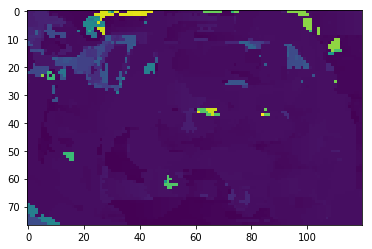

[[ 56.  56.  56. ...  34.  35.  36.]
 [ 57.  57.  69. ...  31.  32.  33.]
 [ 57.  58.  58. ...  31.  32.  33.]
 ...
 [171. 171. 174. ...  27.  27.  27.]
 [171. 171. 175. ...  27.  27.  27.]
 [171. 171. 175. ...  27.  27.  27.]]


In [0]:
disMatrix7 = scan(leftimage, rightimage, leftImageBoundingBox, 7)

C:\Users\Eric\AppData\Local\Programs\Python\Python36\lib\site-packages\ipykernel_launcher.py:60: RuntimeWarning: divide by zero encountered in double_scalars


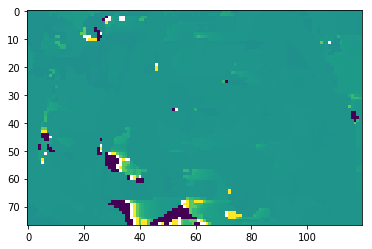

In [0]:
depthMatrix7 = convertDisToDepth(disMatrix7)

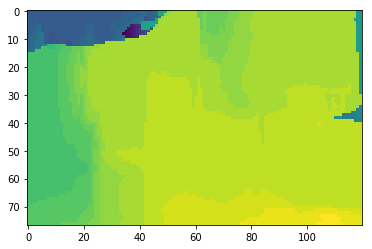

[[ 9.  9.  9. ... 27. 17. 17.]
 [ 9.  9.  9. ... 27. 17. 17.]
 [ 9.  9.  9. ... 27. 17. 17.]
 ...
 [23. 23. 23. ... 30. 30. 30.]
 [23. 23. 23. ... 30. 30. 30.]
 [23. 23. 23. ... 30. 30. 30.]]


In [0]:
disMatrix41 = scan(leftimage, rightimage, leftImageBoundingBox, 41)

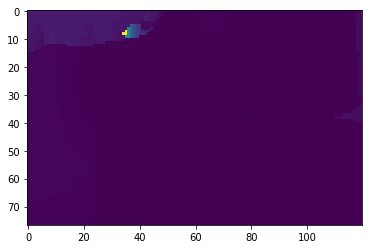

In [0]:
depthMatrix41 = convertDisToDepth(disMatrix41)

In [0]:
the_model = torch.load(directory + "/best.ckpt")

In [0]:
from __future__ import print_function
import torch
import torch.nn as nn
import torch.utils.data
from torch.autograd import Variable
from torch.autograd.function import Function
import torch.nn.functional as F
import numpy as np


def convbn(in_channels, out_channels, kernel_size, stride, pad, dilation):
    return nn.Sequential(nn.Conv2d(in_channels, out_channels, kernel_size=kernel_size, stride=stride,
                                   padding=dilation if dilation > 1 else pad, dilation=dilation, bias=False),
                         nn.BatchNorm2d(out_channels))


def convbn_3d(in_channels, out_channels, kernel_size, stride, pad):
    return nn.Sequential(nn.Conv3d(in_channels, out_channels, kernel_size=kernel_size, stride=stride,
                                   padding=pad, bias=False),
                         nn.BatchNorm3d(out_channels))


def disparity_regression(x, maxdisp):
    assert len(x.shape) == 4
    disp_values = torch.arange(0, maxdisp, dtype=x.dtype, device=x.device)
    disp_values = disp_values.view(1, maxdisp, 1, 1)
    return torch.sum(x * disp_values, 1, keepdim=False)


def build_concat_volume(refimg_fea, targetimg_fea, maxdisp):
    B, C, H, W = refimg_fea.shape
    volume = refimg_fea.new_zeros([B, 2 * C, maxdisp, H, W])
    for i in range(maxdisp):
        if i > 0:
            volume[:, :C, i, :, i:] = refimg_fea[:, :, :, i:]
            volume[:, C:, i, :, i:] = targetimg_fea[:, :, :, :-i]
        else:
            volume[:, :C, i, :, :] = refimg_fea
            volume[:, C:, i, :, :] = targetimg_fea
    volume = volume.contiguous()
    return volume


def groupwise_correlation(fea1, fea2, num_groups):
    B, C, H, W = fea1.shape
    assert C % num_groups == 0
    channels_per_group = C // num_groups
    cost = (fea1 * fea2).view([B, num_groups, channels_per_group, H, W]).mean(dim=2)
    assert cost.shape == (B, num_groups, H, W)
    return cost


def build_gwc_volume(refimg_fea, targetimg_fea, maxdisp, num_groups):
    B, C, H, W = refimg_fea.shape
    volume = refimg_fea.new_zeros([B, num_groups, maxdisp, H, W])
    for i in range(maxdisp):
        if i > 0:
            volume[:, :, i, :, i:] = groupwise_correlation(refimg_fea[:, :, :, i:], targetimg_fea[:, :, :, :-i],
                                                           num_groups)
        else:
            volume[:, :, i, :, :] = groupwise_correlation(refimg_fea, targetimg_fea, num_groups)
    volume = volume.contiguous()
    return volume


class BasicBlock(nn.Module):
    expansion = 1

    def __init__(self, inplanes, planes, stride, downsample, pad, dilation):
        super(BasicBlock, self).__init__()

        self.conv1 = nn.Sequential(convbn(inplanes, planes, 3, stride, pad, dilation),
                                   nn.ReLU(inplace=True))

        self.conv2 = convbn(planes, planes, 3, 1, pad, dilation)

        self.downsample = downsample
        self.stride = stride

    def forward(self, x):
        out = self.conv1(x)
        out = self.conv2(out)

        if self.downsample is not None:
            x = self.downsample(x)

        out += x

        return out



In [0]:
from __future__ import print_function
import torch
import torch.nn as nn
import torch.utils.data
from torch.autograd import Variable
import torch.nn.functional as F
import math


class feature_extraction(nn.Module):
    def __init__(self, concat_feature=False, concat_feature_channel=12):
        super(feature_extraction, self).__init__()
        self.concat_feature = concat_feature

        self.inplanes = 32
        self.firstconv = nn.Sequential(convbn(3, 32, 3, 2, 1, 1),
                                       nn.ReLU(inplace=True),
                                       convbn(32, 32, 3, 1, 1, 1),
                                       nn.ReLU(inplace=True),
                                       convbn(32, 32, 3, 1, 1, 1),
                                       nn.ReLU(inplace=True))

        self.layer1 = self._make_layer(BasicBlock, 32, 3, 1, 1, 1)
        self.layer2 = self._make_layer(BasicBlock, 64, 16, 2, 1, 1)
        self.layer3 = self._make_layer(BasicBlock, 128, 3, 1, 1, 1)
        self.layer4 = self._make_layer(BasicBlock, 128, 3, 1, 1, 2)

        if self.concat_feature:
            self.lastconv = nn.Sequential(convbn(320, 128, 3, 1, 1, 1),
                                          nn.ReLU(inplace=True),
                                          nn.Conv2d(128, concat_feature_channel, kernel_size=1, padding=0, stride=1,
                                                    bias=False))

    def _make_layer(self, block, planes, blocks, stride, pad, dilation):
        downsample = None
        if stride != 1 or self.inplanes != planes * block.expansion:
            downsample = nn.Sequential(
                nn.Conv2d(self.inplanes, planes * block.expansion,
                          kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm2d(planes * block.expansion), )

        layers = []
        layers.append(block(self.inplanes, planes, stride, downsample, pad, dilation))
        self.inplanes = planes * block.expansion
        for i in range(1, blocks):
            layers.append(block(self.inplanes, planes, 1, None, pad, dilation))

        return nn.Sequential(*layers)

    def forward(self, x):
        x = self.firstconv(x)
        x = self.layer1(x)
        l2 = self.layer2(x)
        l3 = self.layer3(l2)
        l4 = self.layer4(l3)

        gwc_feature = torch.cat((l2, l3, l4), dim=1)

        if not self.concat_feature:
            return {"gwc_feature": gwc_feature}
        else:
            concat_feature = self.lastconv(gwc_feature)
            return {"gwc_feature": gwc_feature, "concat_feature": concat_feature}


class hourglass(nn.Module):
    def __init__(self, in_channels):
        super(hourglass, self).__init__()

        self.conv1 = nn.Sequential(convbn_3d(in_channels, in_channels * 2, 3, 2, 1),
                                   nn.ReLU(inplace=True))

        self.conv2 = nn.Sequential(convbn_3d(in_channels * 2, in_channels * 2, 3, 1, 1),
                                   nn.ReLU(inplace=True))

        self.conv3 = nn.Sequential(convbn_3d(in_channels * 2, in_channels * 4, 3, 2, 1),
                                   nn.ReLU(inplace=True))

        self.conv4 = nn.Sequential(convbn_3d(in_channels * 4, in_channels * 4, 3, 1, 1),
                                   nn.ReLU(inplace=True))

        self.conv5 = nn.Sequential(
            nn.ConvTranspose3d(in_channels * 4, in_channels * 2, 3, padding=1, output_padding=1, stride=2, bias=False),
            nn.BatchNorm3d(in_channels * 2))

        self.conv6 = nn.Sequential(
            nn.ConvTranspose3d(in_channels * 2, in_channels, 3, padding=1, output_padding=1, stride=2, bias=False),
            nn.BatchNorm3d(in_channels))

        self.redir1 = convbn_3d(in_channels, in_channels, kernel_size=1, stride=1, pad=0)
        self.redir2 = convbn_3d(in_channels * 2, in_channels * 2, kernel_size=1, stride=1, pad=0)

    def forward(self, x):
        conv1 = self.conv1(x)
        conv2 = self.conv2(conv1)

        conv3 = self.conv3(conv2)
        conv4 = self.conv4(conv3)

        conv5 = F.relu(self.conv5(conv4) + self.redir2(conv2), inplace=True)
        conv6 = F.relu(self.conv6(conv5) + self.redir1(x), inplace=True)

        return conv6


class GwcNet(nn.Module):
    def __init__(self, maxdisp, use_concat_volume=False):
        super(GwcNet, self).__init__()
        self.maxdisp = maxdisp
        self.use_concat_volume = use_concat_volume

        self.num_groups = 40

        if self.use_concat_volume:
            self.concat_channels = 12
            self.feature_extraction = feature_extraction(concat_feature=True,
                                                         concat_feature_channel=self.concat_channels)
        else:
            self.concat_channels = 0
            self.feature_extraction = feature_extraction(concat_feature=False)

        self.dres0 = nn.Sequential(convbn_3d(self.num_groups + self.concat_channels * 2, 32, 3, 1, 1),
                                   nn.ReLU(inplace=True),
                                   convbn_3d(32, 32, 3, 1, 1),
                                   nn.ReLU(inplace=True))

        self.dres1 = nn.Sequential(convbn_3d(32, 32, 3, 1, 1),
                                   nn.ReLU(inplace=True),
                                   convbn_3d(32, 32, 3, 1, 1))

        self.dres2 = hourglass(32)

        self.dres3 = hourglass(32)

        self.dres4 = hourglass(32)

        self.classif0 = nn.Sequential(convbn_3d(32, 32, 3, 1, 1),
                                      nn.ReLU(inplace=True),
                                      nn.Conv3d(32, 1, kernel_size=3, padding=1, stride=1, bias=False))

        self.classif1 = nn.Sequential(convbn_3d(32, 32, 3, 1, 1),
                                      nn.ReLU(inplace=True),
                                      nn.Conv3d(32, 1, kernel_size=3, padding=1, stride=1, bias=False))

        self.classif2 = nn.Sequential(convbn_3d(32, 32, 3, 1, 1),
                                      nn.ReLU(inplace=True),
                                      nn.Conv3d(32, 1, kernel_size=3, padding=1, stride=1, bias=False))

        self.classif3 = nn.Sequential(convbn_3d(32, 32, 3, 1, 1),
                                      nn.ReLU(inplace=True),
                                      nn.Conv3d(32, 1, kernel_size=3, padding=1, stride=1, bias=False))

        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                n = m.kernel_size[0] * m.kernel_size[1] * m.out_channels
                m.weight.data.normal_(0, math.sqrt(2. / n))
            elif isinstance(m, nn.Conv3d):
                n = m.kernel_size[0] * m.kernel_size[1] * m.kernel_size[2] * m.out_channels
                m.weight.data.normal_(0, math.sqrt(2. / n))
            elif isinstance(m, nn.BatchNorm2d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()
            elif isinstance(m, nn.BatchNorm3d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()
            elif isinstance(m, nn.Linear):
                m.bias.data.zero_()

    def forward(self, left, right):
        features_left = self.feature_extraction(left)
        features_right = self.feature_extraction(right)

        gwc_volume = build_gwc_volume(features_left["gwc_feature"], features_right["gwc_feature"], self.maxdisp // 4,
                                      self.num_groups)
        if self.use_concat_volume:
            concat_volume = build_concat_volume(features_left["concat_feature"], features_right["concat_feature"],
                                                self.maxdisp // 4)
            volume = torch.cat((gwc_volume, concat_volume), 1)
        else:
            volume = gwc_volume

        cost0 = self.dres0(volume)
        cost0 = self.dres1(cost0) + cost0

        out1 = self.dres2(cost0)
        out2 = self.dres3(out1)
        out3 = self.dres4(out2)

        if self.training:
            cost0 = self.classif0(cost0)
            cost1 = self.classif1(out1)
            cost2 = self.classif2(out2)
            cost3 = self.classif3(out3)

            cost0 = F.upsample(cost0, [self.maxdisp, left.size()[2], left.size()[3]], mode='trilinear')
            cost0 = torch.squeeze(cost0, 1)
            pred0 = F.softmax(cost0, dim=1)
            pred0 = disparity_regression(pred0, self.maxdisp)

            cost1 = F.upsample(cost1, [self.maxdisp, left.size()[2], left.size()[3]], mode='trilinear')
            cost1 = torch.squeeze(cost1, 1)
            pred1 = F.softmax(cost1, dim=1)
            pred1 = disparity_regression(pred1, self.maxdisp)

            cost2 = F.upsample(cost2, [self.maxdisp, left.size()[2], left.size()[3]], mode='trilinear')
            cost2 = torch.squeeze(cost2, 1)
            pred2 = F.softmax(cost2, dim=1)
            pred2 = disparity_regression(pred2, self.maxdisp)

            cost3 = F.upsample(cost3, [self.maxdisp, left.size()[2], left.size()[3]], mode='trilinear')
            cost3 = torch.squeeze(cost3, 1)
            pred3 = F.softmax(cost3, dim=1)
            pred3 = disparity_regression(pred3, self.maxdisp)
            return [pred0, pred1, pred2, pred3]

        else:
            cost3 = self.classif3(out3)
            cost3 = F.upsample(cost3, [self.maxdisp, left.size()[2], left.size()[3]], mode='trilinear')
            cost3 = torch.squeeze(cost3, 1)
            pred3 = F.softmax(cost3, dim=1)
            pred3 = disparity_regression(pred3, self.maxdisp)
            return [pred3]


def GwcNet_G(d):
    return GwcNet(d, use_concat_volume=False)


def GwcNet_GC(d):
    return GwcNet(d, use_concat_volume=True)

In [0]:
import os
import random
from torch.utils.data import Dataset
from PIL import Image
import numpy as np
#from datasets.data_io import get_transform, read_all_lines


class CustomData(Dataset):
    def __init__(self, dataList):
        self.dataList = dataList

    def get_transform(self):
      mean = [0.485, 0.456, 0.406]
      std = [0.229, 0.224, 0.225]

      return transforms.Compose([
          transforms.ToTensor(),
          transforms.Normalize(mean=mean, std=std),
      ])

    def __len__(self):
        return len(self.dataList) - 1

    def __getitem__(self, index):
        left_img = self.dataList[index]
        right_img = self.dataList[index + 1]

        h = left_img.shape[0]
        w = left_img.shape[1]

        # normalize
        processed = self.get_transform()
        left_img = processed(left_img).numpy()
        right_img = processed(right_img).numpy()

        # pad to size 1248x384
        top_pad = 384 - h
        right_pad = 1248 - w
        assert top_pad > 0 and right_pad > 0
        # pad images
        left_img = np.lib.pad(left_img, ((0, 0), (top_pad, 0), (0, right_pad)), mode='constant', constant_values=0)
        right_img = np.lib.pad(right_img, ((0, 0), (top_pad, 0), (0, right_pad)), mode='constant',
                                constant_values=0)
        return {"left": left_img,
                "right": right_img,
                "top_pad": top_pad,
                "right_pad": right_pad}

In [0]:
left_img = leftimage.copy()
right_img = rightimage.copy()

dataset = CustomData([left_img, right_img])
dataloader = torch.utils.data.DataLoader(dataset, 1, shuffle=False, num_workers=4, drop_last=False)

In [0]:
model = GwcNet_G(192)
model = nn.DataParallel(model)

In [0]:
model.load_state_dict(the_model['model'])

<All keys matched successfully>

In [0]:
def getDispMap(dataloader):
  results = []
  model.eval()
  for idx, sample in enumerate(dataloader):
    y = model(sample['left'], sample['right'])
    result = y[-1].cpu().data.numpy()[0]
    plt.imshow(result)
    plt.show()
    results.append(result)

  return results


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2404: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=trilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


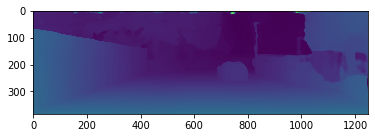

In [0]:
results = getDispMap(dataloader)

In [0]:
def convert2DTo3DPoint(x, y, w):
  point2D = [w * x, w * y, w]
  #print(point2D.shape)
  k = [[f, 0, px],
       [0, f, py],
       [0, 0, 1]]

  point3D = np.linalg.solve(np.asarray(k), np.asarray(point2D))
  
  return point3D


def drawBoundingBoxPoints(image, x, y, z):
  img = image.copy()
  px = 609.559300
  py = 172.854000
  f = 721.537700
  points = [[], [], [], [], [], [], [], []]
  points[0] = [x[0], y[0], z[0]]
  points[1] = [x[0], y[1], z[0]]
  points[2] = [x[1], y[0], z[0]]
  points[3] = [x[1], y[1], z[0]]
  points[4] = [x[0], y[0], z[1]]
  points[5] = [x[0], y[1], z[1]]
  points[6] = [x[1], y[0], z[1]]
  points[7] = [x[1], y[1], z[1]]

  points = np.asarray(points)

  k = np.asarray(
      [[f, 0, px],
       [0, f, py],
       [0, 0, 1]])

  for i in range(points.shape[0]):
    points[i] = np.dot(k, points[i])
    #print(points[i, :].shape)
    points[i, :] = points[i, :] / points[i, 2]

  points = np.round(points)
  points = points.astype(int)

  lines = [
            [0, 1], 
            [0, 2], 
            [0, 4],
            [1, 3], 
            [1, 5],
            [2, 3], 
            [2, 6],
            [3, 7],
            [4, 5], 
            [4, 6],
            [5, 7], 
            [6, 7]]


  for i in range(len(lines)):
    line = lines[i]
    tuple1 = tuple(points[line[0]][:-1])
    tuple2 = tuple(points[line[1]][:-1])
    img = cv2.line(img, tuple1, tuple2, (0, 255, 0), 5) 

  plt.imshow(img)
  plt.show()

  #return points



def find3DCarBox(image, depthMap, boundingBox):
    points3D = np.zeros((3, (boundingBox[3]-boundingBox[2]) * (boundingBox[1] - boundingBox[0])))
    valid_points = []
    mask = np.zeros(((boundingBox[3]-boundingBox[2]), (boundingBox[1] - boundingBox[0])))
    counter = 0

    mid = convert2DTo3DPoint(745, 220, (f * baseline) / depthMap[220, 745])

    for i in range(boundingBox[2], boundingBox[3]):
      for j in range(boundingBox[0], boundingBox[1]):
        depth = (f * baseline) / depthMap[i, j]
        point3D = convert2DTo3DPoint(j, i, depth)
        points3D[:, counter] = point3D

        if abs(point3D[1] - mid[1]) < 0.7 and abs(point3D[0] - mid[0]) < 1 and abs(point3D[2] - mid[2]) < 3.5:
          mask[i - boundingBox[2], j - boundingBox[0]] = 1
          valid_points.append(point3D)

        counter += 1

    valid_points = np.asarray(valid_points)

    x_ = [np.min(valid_points[:, 0]), np.max(valid_points[:, 0])]
    y_ = [np.min(valid_points[:, 1]), np.max(valid_points[:, 1])]
    z_ = [np.min(valid_points[:, 2]), np.max(valid_points[:, 2])]

    drawBoundingBoxPoints(image, x_, y_, z_)

    plt.imshow(mask)
    plt.show()
    print(np.median(points3D[0, :]), np.median(points3D[1, :]), np.median(points3D[2, :]))
    print(np.mean(points3D[0, :]), np.mean(points3D[1, :]), np.mean(points3D[2, :]))

    img = boundedImage.copy()[:, :, 0]
    img = mask * img

    plt.imshow(img)
    plt.show()

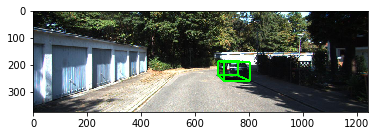

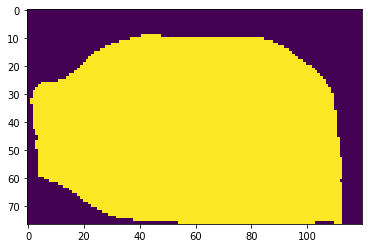

2.7788493579814486 0.9902539520119744 13.966073672121311
3.505362055475086 1.0209136975320572 18.742412995994563


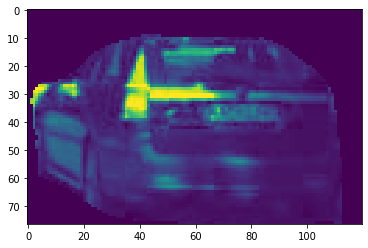

In [0]:
find3DCarBox(leftimage, results[0], leftImageBoundingBox)

In [0]:
!pip install opencv-python==3.4.2.16
!pip install opencv-contrib-python==3.4.2.16

     |████████████████████████████████| 25.0MB 1.6MB/s 
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: opencv-python 3.4.7.28
    Uninstalling opencv-python-3.4.7.28:
      Successfully uninstalled opencv-python-3.4.7.28


     |████████████████████████████████| 30.6MB 57.1MB/s 
  Found existing installation: opencv-contrib-python 3.4.3.18
    Uninstalling opencv-contrib-python-3.4.3.18:
      Successfully uninstalled opencv-contrib-python-3.4.3.18


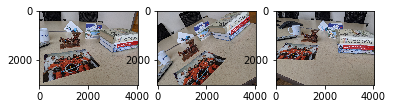

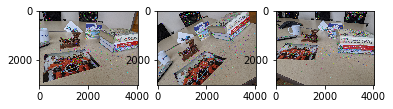

In [0]:
image1 = io.imread(directory + 'I1.jpg', )
image2 = io.imread(directory + 'I2.jpg')
image3 = io.imread(directory + 'I3.jpg')

fig, ax = plt.subplots(1, 3)
ax[0].imshow(image1)
ax[1].imshow(image2)
ax[2].imshow(image3)
plt.show()

sift = cv2.xfeatures2d.SIFT_create()
kp1 = sift.detect(image1, None)
img1 = cv2.drawKeypoints(image1.copy(),kp1,image1.copy())

kp2 = sift.detect(image2, None)
img2 = cv2.drawKeypoints(image2.copy(),kp2,image2.copy())

kp3 = sift.detect(image3, None)
img3 = cv2.drawKeypoints(image3.copy(),kp3,image3.copy())

fig, ax = plt.subplots(1, 3)
ax[0].imshow(img1)
ax[1].imshow(img2)
ax[2].imshow(img3)
plt.show()

kp1,des1 = sift.compute(image1,kp1)
kp2,des2 = sift.compute(image2,kp2)
kp3,des3 = sift.compute(image3,kp3)


In [0]:
  def findMatches(des1, des2, threshold):
    FLANN_INDEX_KDTREE = 0
    index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
    search_params = dict(checks = 50)
    flann = cv2.FlannBasedMatcher(index_params, search_params)
    matches = flann.knnMatch(des1,des2,k=2)

    good = []

    MIN_MATCH_COUNT = 8

    for m,n in matches:
      if m.distance < threshold*n.distance:
        good.append(m)

    return good

In [0]:
matches12 = findMatches(des1, des2, 0.3)
matches13 = findMatches(des1, des3, 0.7)

In [0]:
print(len(matches12))
print(len(matches13))

2695
1150


In [0]:
def getMatchAcrossImages(matches12, matches13, kp1, kp2, kp3):
  samePointMatches = []
  kp_1 = np.float32([ kp1[m.queryIdx].pt for m in matches12 ]).reshape(-1,1,2)
  kp_2 = np.float32([ kp2[m.trainIdx].pt for m in matches12 ]).reshape(-1,1,2)

  kp_11 = np.float32([ kp1[m.queryIdx].pt for m in matches13 ]).reshape(-1,1,2)
  kp_3 = np.float32([ kp3[m.trainIdx].pt for m in matches13 ]).reshape(-1,1,2)

  print(kp_1.shape, kp_2.shape, kp_11.shape, kp_3.shape)

  matchingPoints = []
  seen = set()

  for pt1, pt2 in zip(kp_1, kp_2):
    for pt11, pt3 in zip(kp_11, kp_3):
      #print(pt1, pt11)
      if np.array_equal(np.asarray(pt1[0]), np.asarray(pt11[0])):
        if (pt1[0, 0], pt1[0, 1]) not in seen and (pt2[0, 0], pt2[0, 1]) not in seen and (pt3[0, 0], pt3[0, 1]) not in seen:
          matchingPoints.append((pt1, pt2, pt3))
          seen.add((pt1[0, 0], pt1[0, 1]))
          seen.add((pt2[0, 0], pt2[0, 1]))
          seen.add((pt3[0, 0], pt3[0, 1]))

  print(len(matchingPoints))
  return matchingPoints

  


In [0]:
matchingPoints = getMatchAcrossImages(matches12, matches13, kp1, kp2, kp3)

(2695, 1, 2) (2695, 1, 2) (1150, 1, 2) (1150, 1, 2)
394


In [0]:
matches8 = [matchingPoints[0], matchingPoints[4], matchingPoints[12], matchingPoints[13], matchingPoints[50], matchingPoints[200], matchingPoints[300], matchingPoints[330]]

In [0]:
sideBySide12 = np.concatenate((image1.copy(), image2.copy()), axis=1)
counter = 0
points12 = []
points12_unrounded = []

for pt1, pt2, pt3 in matches8:
    newpt1 = tuple(np.round(np.asarray(pt1[0]).astype(int)))
    newpt2 = tuple(np.round(np.asarray([pt2[0, 0] + image1.shape[1], pt2[0, 1]])).astype(int))
    print(counter, newpt1, newpt2)
    sideBySide12 = cv2.line(sideBySide12.copy(), newpt1, newpt2, (0, 255, 0), 5)
    points12_unrounded.append([np.asarray(pt1[0]), np.asarray(pt2[0])])
    points12.append([np.round(np.asarray(pt1[0]).astype(int)), np.round(np.asarray(pt2[0])).astype(int)])
    counter += 1

points12_unrounded = np.asarray(points12_unrounded)
points12 = np.asarray(points12)

0 (112, 1001) (4231, 1966)
1 (241, 1044) (4360, 1939)
2 (349, 2053) (4949, 2776)
3 (595, 2305) (5273, 2881)
4 (1410, 812) (5227, 1152)
5 (2078, 1037) (5911, 1049)
6 (3136, 1434) (7012, 930)
7 (3244, 1523) (7149, 949)


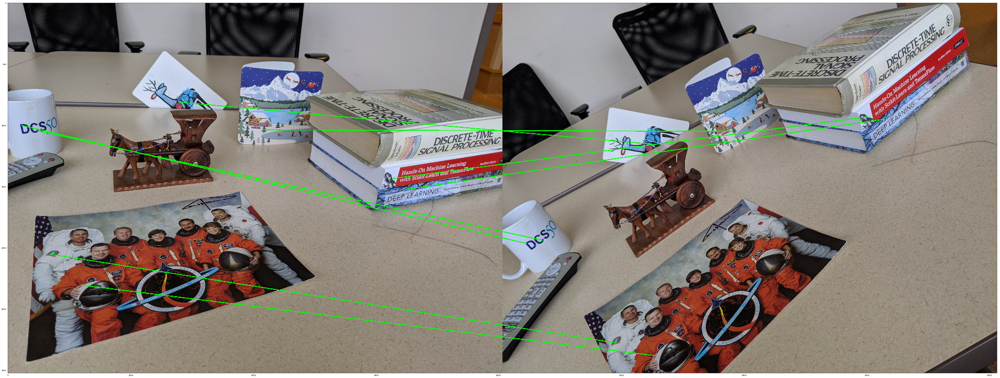

In [0]:
width=2016 # pixels
height=1512
margin=50 # pixels
dpi=30

figsize=((width+2*margin)/dpi, (height+2*margin)/dpi) # inches
left = margin/dpi/figsize[0] #axes ratio
bottom = margin/dpi/figsize[1]

fig = plt.figure(figsize=figsize, dpi=dpi)
fig.subplots_adjust(left=left, bottom=bottom, right=1.-left, top=1.-bottom)
plt.imshow(sideBySide12)
plt.show()

In [0]:
sideBySide13 = np.concatenate((image1.copy(), image3.copy()), axis=1)
points13 = []
points13_unrounded = []
counter = 0

for pt1, pt2, pt3 in matches8:
    newpt1 = tuple(np.round(np.asarray(pt1[0]).astype(int)))
    newpt2 = tuple(np.round(np.asarray([pt3[0, 0] + image1.shape[1], pt3[0, 1]])).astype(int))
    print(counter, newpt1, newpt2)
    #print(counter, np.asarray(pt1[0]), np.asarray(pt3[0]))
    points13.append([np.round(np.asarray(pt1[0]).astype(int)), np.round(np.asarray(pt3[0])).astype(int)])
    points13_unrounded.append([np.asarray(pt1[0]), np.asarray(pt3[0])])
    sideBySide13 = cv2.line(sideBySide13.copy(), newpt1, newpt2, (0, 255, 0), 5) 
    counter += 1

points13_unrounded = np.asarray(points13_unrounded)
points13 = np.asarray(points13)

0 (112, 1001) (4767, 778)
1 (241, 1044) (4854, 824)
2 (349, 2053) (4350, 1499)
3 (595, 2305) (4339, 1684)
4 (1410, 812) (6039, 768)
5 (2078, 1037) (6319, 1004)
6 (3136, 1434) (6708, 1454)
7 (3244, 1523) (6885, 1583)


In [0]:
def showMatches(image):
  width=2016 # pixels
  height=1512
  margin=50 # pixels
  dpi=30

  figsize=((width+2*margin)/dpi, (height+2*margin)/dpi) # inches
  left = margin/dpi/figsize[0] #axes ratio
  bottom = margin/dpi/figsize[1]

  fig = plt.figure(figsize=figsize, dpi=dpi)
  fig.subplots_adjust(left=left, bottom=bottom, right=1.-left, top=1.-bottom)
  plt.imshow(image)
  plt.show()

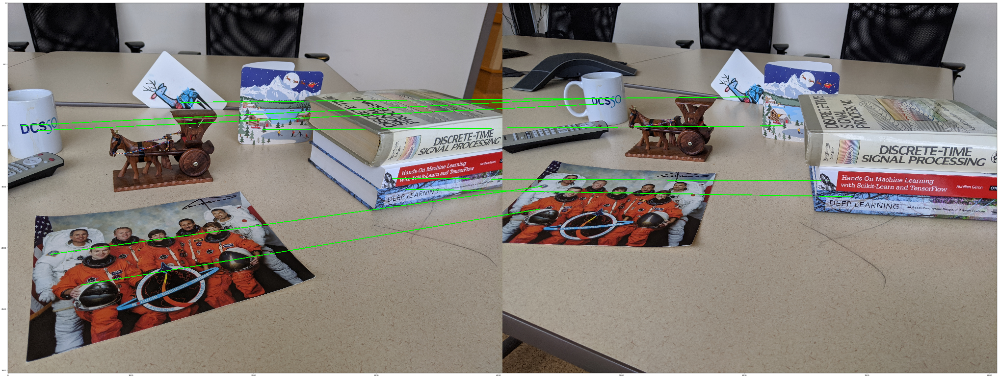

In [0]:
showMatches(sideBySide13)

In [0]:
def computeFundamental(xright, xleft):    
    n = xright.shape[0]

    A = np.zeros((n,9))
    for i in range(n):
        A[i] = [xright[i, 0]*xleft[i, 0], xright[i, 0]*xleft[i, 1], xright[i, 0],
                xright[i, 1]*xleft[i, 0], xright[i, 1]*xleft[i, 1], xright[i, 1],
                xleft[i, 0], xleft[i, 1], 1]
            
    U,S,V = np.linalg.svd(A)
    
    F = V[-1].reshape(3,3)
    
    U,S,V = np.linalg.svd(F)
    S[2] = 0
    F = np.dot(U,np.dot(np.diag(S),V))

    return F/F[2,2]

In [0]:
F12 = computeFundamental(points12_unrounded[:, 1], points12_unrounded[:, 0])

In [0]:
F13 = computeFundamental(points13_unrounded[:, 1], points13_unrounded[:, 0])

In [0]:
print(F12)
print(F13)

[[ 6.86751718e-08 -1.26507741e-07  1.37897020e-03]
 [ 1.42109921e-07  8.06799106e-08 -3.84607320e-04]
 [-1.47571553e-03 -5.21173119e-04  1.00000000e+00]]
[[ 8.60573527e-08 -3.59014601e-07 -7.65646549e-04]
 [-4.19364518e-07  3.36406605e-07  5.92964889e-03]
 [ 4.46875515e-04 -5.06238966e-03  1.00000000e+00]]


In [0]:
Fcv2_12, mask_12 = cv2.findFundamentalMat(points12_unrounded[:, 0], points12_unrounded[:, 1], cv2.FM_8POINT) 
print(Fcv2_12)
print(np.all(np.isclose(Fcv2_12, F12, atol=1e-2)))

[[ 6.87624484e-08 -1.26544974e-07  1.38140254e-03]
 [ 1.42818465e-07  8.04784313e-08 -3.84249536e-04]
 [-1.47968020e-03 -5.19231951e-04  1.00000000e+00]]
True


In [0]:
Fcv2_13, mask_13 = cv2.findFundamentalMat(points13_unrounded[:, 0], points13_unrounded[:, 1], cv2.FM_8POINT) 
print(Fcv2_13)

[[ 8.96518314e-08 -3.72134161e-07 -7.73653210e-04]
 [-4.37225611e-07  3.50227763e-07  6.17439997e-03]
 [ 4.94691560e-04 -5.26707803e-03  1.00000000e+00]]


In [0]:
def drawlines(img1, lines, pts1):
    print(img1.shape)
    r, c, d = img1.shape
    
    for r,pt1 in zip(lines, pts1):
        color = tuple(np.random.randint(0,255,3).tolist())
        x0,y0 = map(int, [0, -r[2]/r[1] ])
        x1,y1 = map(int, [c, -(r[2]+r[0]*c)/r[1] ])
        img1 = cv2.line(img1, (x0,y0), (x1,y1), color, 2)
        img1 = cv2.circle(img1, tuple(pt1), 15, color, -1)
        
    return img1

In [0]:
def createEpipolarLine(img1, img2, leftPoints, rightPoints, F):
    lines1 = cv2.computeCorrespondEpilines(leftPoints, 2, F)
    lines1 = lines1.reshape(-1,3)

    img5 = drawlines(img2.copy(), lines1, rightPoints)

    width=2016 # pixels
    height=1512
    margin=50 # pixels
    dpi=30

    figsize=((width+2*margin)/dpi, (height+2*margin)/dpi) # inches
    left = margin/dpi/figsize[0] #axes ratio
    bottom = margin/dpi/figsize[1]

    fig = plt.figure(figsize=figsize, dpi=dpi)
    fig.subplots_adjust(left=left, bottom=bottom, right=1.-left, top=1.-bottom),plt.imshow(img5)

    plt.show()

(3024, 4032, 3)


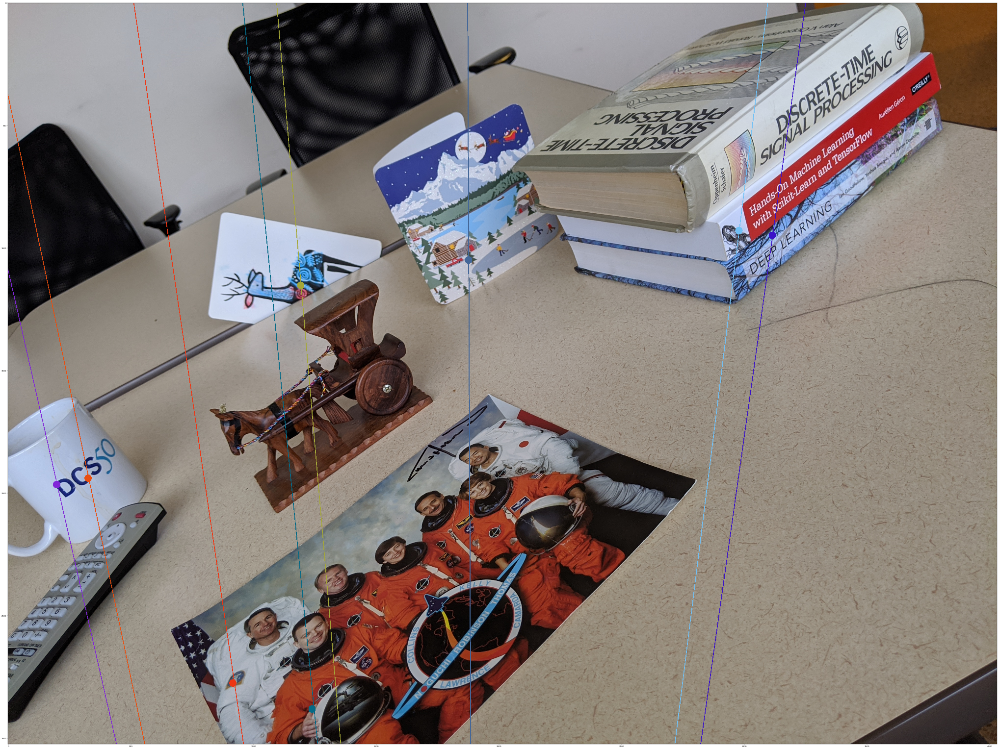

In [0]:
createEpipolarLine(image1, image2, points12_unrounded[:, 0], points12_unrounded[:, 1], F12.T)

(3024, 4032, 3)


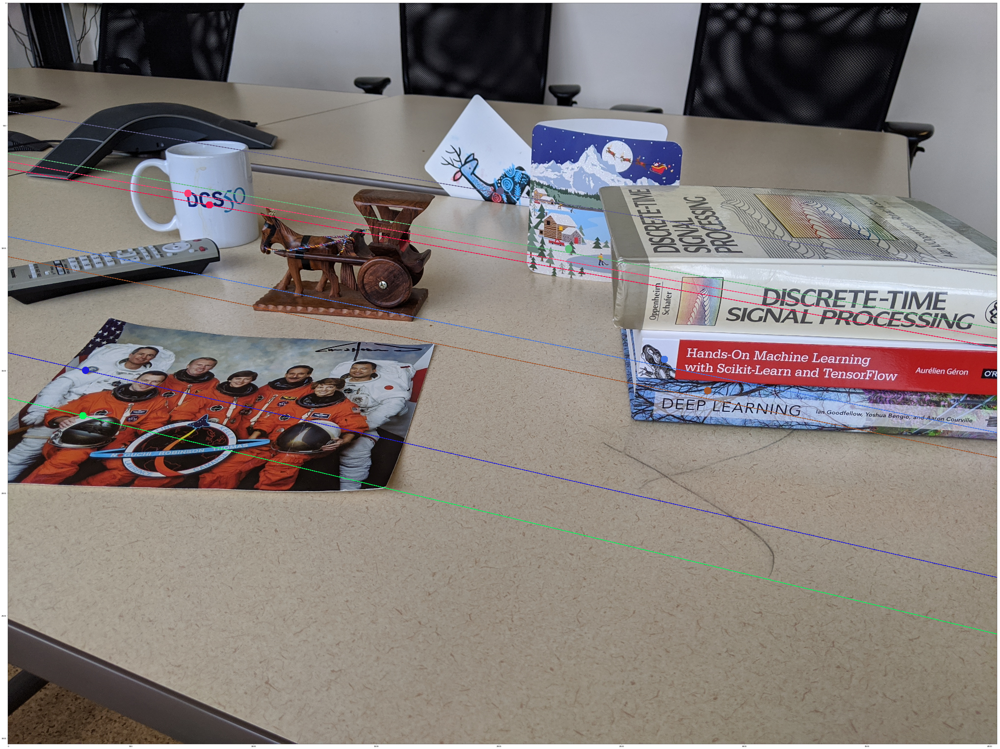

In [0]:
createEpipolarLine(image1, image3, points13_unrounded[:, 0], points13_unrounded[:, 1] , F13.T)

In [0]:
def computeRectify(Imgright, ptleft, ptright, F):
    x1 = np.float64([pl for pl in ptleft])
    x2 = np.float64([pr for pr in ptright])
    
    print(len(x1), len(x2))
    
    retval, H1, H2 = cv2.stereoRectifyUncalibrated(x1, x2, F, (Imgright.shape[0], Imgright.shape[1]), threshold=5)
    
    right_img_remap = cv2.warpPerspective(Imgright.copy(), np.dot(np.linalg.inv(H1), H2), (Imgright.shape[1],Imgright.shape[0]))
    
    return right_img_remap

8 8


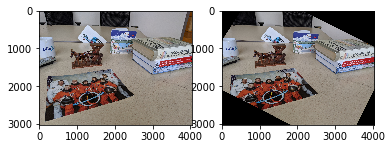

In [0]:
right_img_remap_12 = computeRectify(image2.copy(), points12_unrounded[:, 0], points12_unrounded[:, 1], F12)
fig, ax = plt.subplots(1, 2)
ax[0].imshow(image1)
ax[1].imshow(right_img_remap_12)
plt.show()

8 8


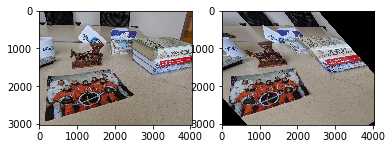

In [0]:
right_img_remap_13 = computeRectify(image3.copy(), points13_unrounded[:, 0], points13_unrounded[:, 1], F13)
fig, ax = plt.subplots(1, 2)
ax[0].imshow(image1, cmap='gray')
ax[1].imshow(right_img_remap_13, cmap='gray')
plt.show()

In [0]:
Fcv2_12, mask_12 = cv2.findFundamentalMat(points12_unrounded[:, 0], points12_unrounded[:, 1], cv2.FM_8POINT) 
Fcv2_13, mask_13 = cv2.findFundamentalMat(points13_unrounded[:, 0], points13_unrounded[:, 1], cv2.FM_8POINT) 

In [0]:
print(F12)
print(Fcv2_12)

print(F13)
print(Fcv2_13)

[[ 6.86751718e-08 -1.26507741e-07  1.37897020e-03]
 [ 1.42109921e-07  8.06799106e-08 -3.84607320e-04]
 [-1.47571553e-03 -5.21173119e-04  1.00000000e+00]]
[[ 6.87624484e-08 -1.26544974e-07  1.38140254e-03]
 [ 1.42818465e-07  8.04784313e-08 -3.84249536e-04]
 [-1.47968020e-03 -5.19231951e-04  1.00000000e+00]]
[[ 8.60573527e-08 -3.59014601e-07 -7.65646549e-04]
 [-4.19364518e-07  3.36406605e-07  5.92964889e-03]
 [ 4.46875515e-04 -5.06238966e-03  1.00000000e+00]]
[[ 8.96518314e-08 -3.72134161e-07 -7.73653210e-04]
 [-4.37225611e-07  3.50227763e-07  6.17439997e-03]
 [ 4.94691560e-04 -5.26707803e-03  1.00000000e+00]]


(3024, 4032, 3)


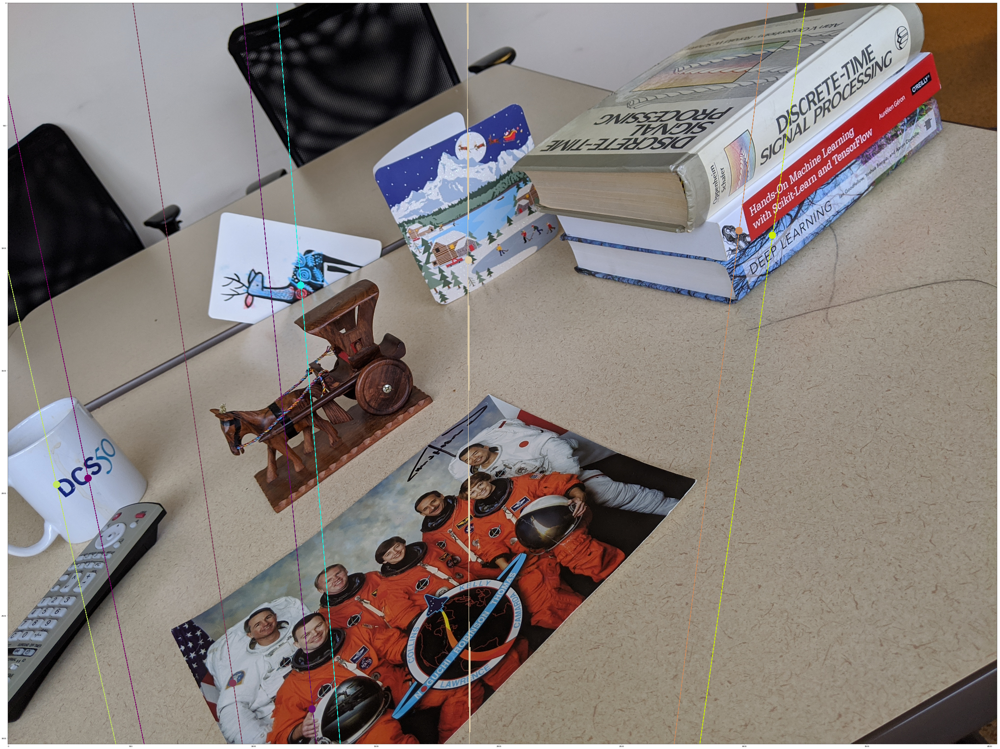

In [0]:
createEpipolarLine(image1, image2, points12_unrounded[:, 0], points12_unrounded[:, 1], Fcv2_12.T)

(3024, 4032, 3)


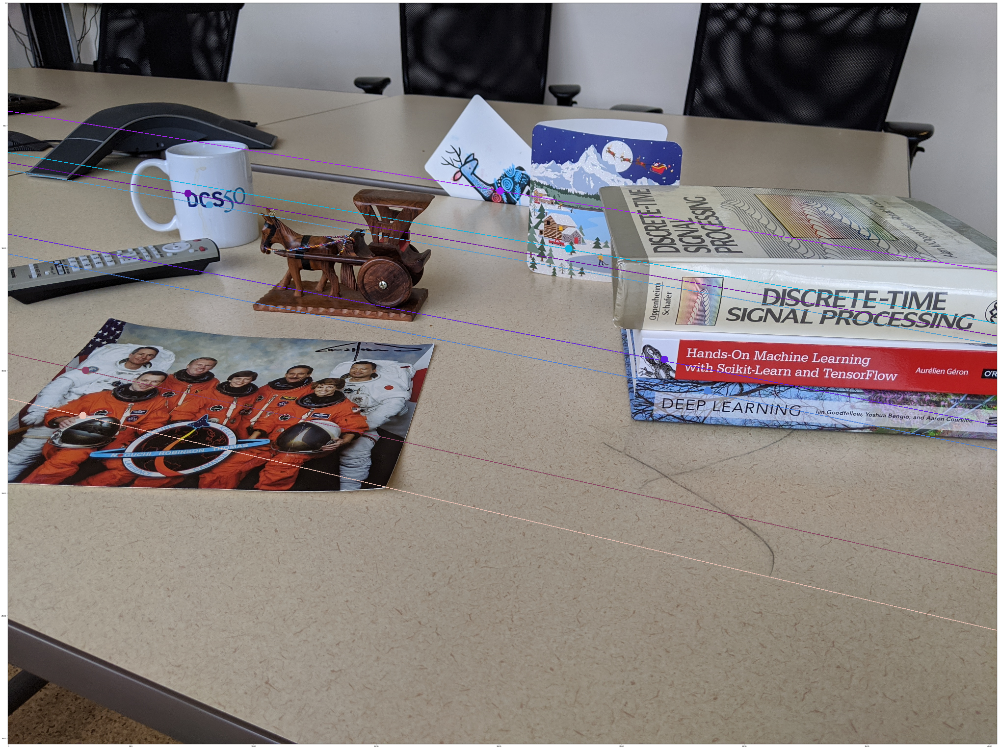

In [0]:
createEpipolarLine(image1, image3, points13_unrounded[:, 0], points13_unrounded[:, 1], Fcv2_13.T)

8 8


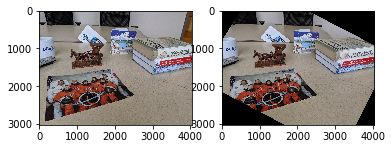

In [0]:
right_img_remap_12 = computeRectify(image2.copy(), points12_unrounded[:, 0], points12_unrounded[:, 1], Fcv2_12)
fig, ax = plt.subplots(1, 2)
ax[0].imshow(image1, cmap='gray')
ax[1].imshow(right_img_remap_12, cmap='gray')
plt.show()

8 8


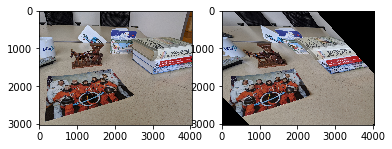

In [0]:
right_img_remap_13 = computeRectify(image3.copy(), points13_unrounded[:, 0], points13_unrounded[:, 1], Fcv2_13)
fig, ax = plt.subplots(1, 2)
ax[0].imshow(image1, cmap='gray')
ax[1].imshow(right_img_remap_13, cmap='gray')
plt.show()